In [1]:
pip install gmplot


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 164.7/164.7 kB 3.4 MB/s eta 0:00:00


In [2]:
pip install cartopy

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.8/11.8 MB 22.8 MB/s eta 0:00:00


In [3]:
pip install basemap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 935.8/935.8 kB 5.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 30.5/30.5 MB 28.0 MB/s eta 0:00:00


In [4]:
import pandas as pd

In [5]:
file_135='/content/df_135_labeled_on_lift.csv'
df_135=pd.read_csv(file_135)

In [6]:
df_135.columns

Index(['Timestamp', 'accelX(g)', 'accelY(g)', 'accelZ(g)', 'accelUserX(g)',
       'accelUserY(g)', 'accelUserZ(g)', 'gyroX(rad/s)', 'gyroY(rad/s)',
       'gyroZ(rad/s)', 'Roll(rads)', 'Pitch(rads)', 'Yaw(rads)', 'm11', 'm12',
       'm13', 'm21', 'm22', 'm23', 'm31', 'm32', 'm33', 'qX', 'qY', 'qZ', 'qW',
       'Lat', 'Long', 'Speed(m/s)', 'TrueHeading', 'Alt(m)',
       'HorizontalAccuracy(m)', 'VerticalAccuracy(m)', 'Course',
       'ActivityType', 'ActivityConfidence', 'Pressure(kilopascals)',
       'RelativeAltitude(meters)', 'magX(µT)', 'magY(µT)', 'magZ(µT)',
       'calMagX(µT)', 'calMagY(µT)', 'calMagZ(µT)', 'on_lift'],
      dtype='object')

In [7]:
df_135.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8113 entries, 0 to 8112
Data columns (total 45 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Timestamp                 8113 non-null   object 
 1   accelX(g)                 8113 non-null   float64
 2   accelY(g)                 8113 non-null   float64
 3   accelZ(g)                 8113 non-null   float64
 4   accelUserX(g)             8113 non-null   float64
 5   accelUserY(g)             8113 non-null   float64
 6   accelUserZ(g)             8113 non-null   float64
 7   gyroX(rad/s)              8113 non-null   float64
 8   gyroY(rad/s)              8113 non-null   float64
 9   gyroZ(rad/s)              8113 non-null   float64
 10  Roll(rads)                8113 non-null   float64
 11  Pitch(rads)               8113 non-null   float64
 12  Yaw(rads)                 8113 non-null   float64
 13  m11                       8113 non-null   float64
 14  m12     

In [8]:
df_135['ActivityConfidence'].value_counts

<bound method IndexOpsMixin.value_counts of 0       High
1       High
2        Low
3       High
4       High
        ... 
8108    High
8109    High
8110    High
8111    High
8112    High
Name: ActivityConfidence, Length: 8113, dtype: object>

In [9]:
df_135['ActivityConfidence'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 8113 entries, 0 to 8112
Series name: ActivityConfidence
Non-Null Count  Dtype 
--------------  ----- 
8113 non-null   object
dtypes: object(1)
memory usage: 63.5+ KB


In [10]:
df_135['ActivityConfidence'].describe()

count     8113
unique       3
top       High
freq      7696
Name: ActivityConfidence, dtype: object

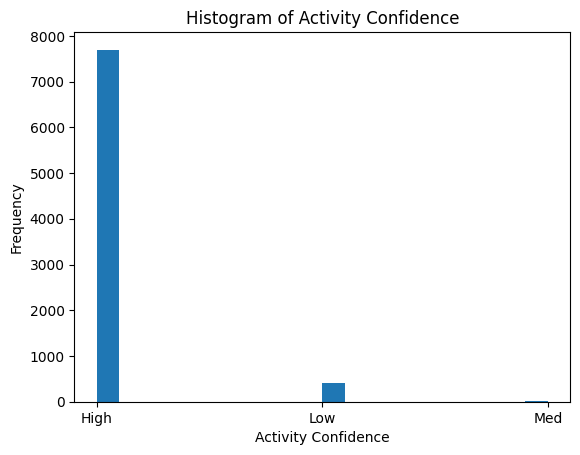

In [11]:
import matplotlib.pyplot as plt

plt.hist(df_135['ActivityConfidence'], bins=20)
plt.xlabel('Activity Confidence')
plt.ylabel('Frequency')
plt.title('Histogram of Activity Confidence')
plt.show()

In [12]:
df_135['ActivityType'].describe()

count        8113
unique          5
top       Unknown
freq         4651
Name: ActivityType, dtype: object

In [13]:
df_135['ActivityType'].value_counts()

Unknown       4651
Walking       1399
Stationary    1045
Cycling        738
Automotive     280
Name: ActivityType, dtype: int64

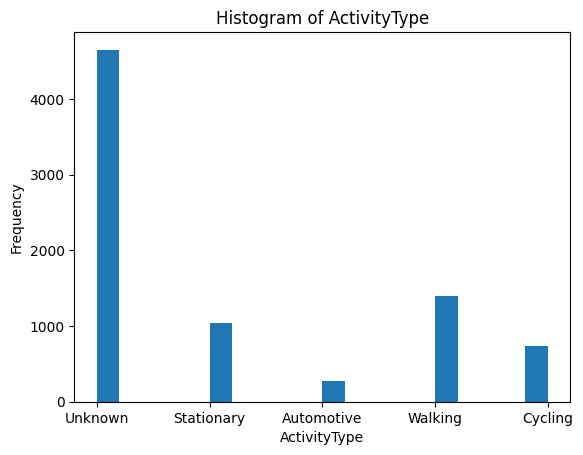

In [14]:
import matplotlib.pyplot as plt

plt.hist(df_135['ActivityType'], bins=20)
plt.xlabel('ActivityType')
plt.ylabel('Frequency')
plt.title('Histogram of ActivityType')
plt.show()

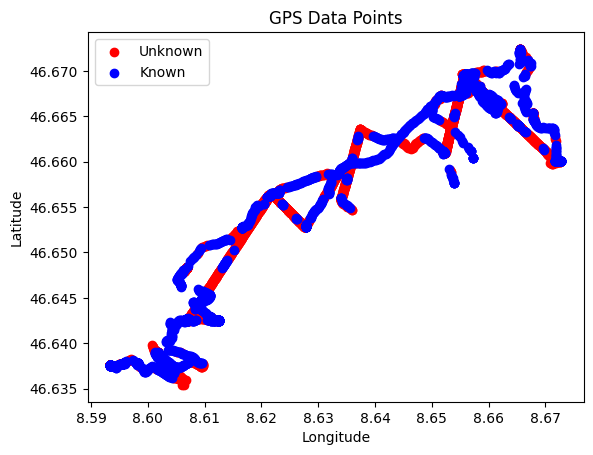

In [16]:
import matplotlib.pyplot as plt

# Plot data points with Unknown activity type
unknown_data = df_135[df_135['ActivityType'] == 'Unknown']
plt.scatter(unknown_data['Long'], unknown_data['Lat'], c='red', label='Unknown')

# Plot data points with other activity types
known_data = df_135[df_135['ActivityType'] != 'Unknown']
plt.scatter(known_data['Long'], known_data['Lat'], c='blue', label='Known')

plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('GPS Data Points')
plt.legend()
plt.show()

In [49]:
pip install folium

In [61]:
import folium
from folium import plugins

# Create a map centered on the mean latitude and longitude
map_center = [df_135['Lat'].mean(), df_135['Long'].mean()]
mymap = folium.Map(location=map_center, zoom_start=10)

# Plot data points with Unknown activity type
unknown_data = df_135[df_135['on_lift'] == 1]
for _, row in unknown_data.iterrows():
    folium.CircleMarker(location=[row['Lat'], row['Long']], radius=5, color='red', fill=True, fill_color='red').add_to(mymap)

# Plot data points with other activity types
known_data = df_135[df_135['on_lift'] == 0]
for _, row in known_data.iterrows():
    folium.CircleMarker(location=[row['Lat'], row['Long']], radius=5, color='blue', fill=True, fill_color='blue').add_to(mymap)

# Display the map in the notebook
mymap

In [57]:
file_166='/content/df_166m_labeled_on_lift.csv.csv'
df_166=pd.read_csv(file_166)

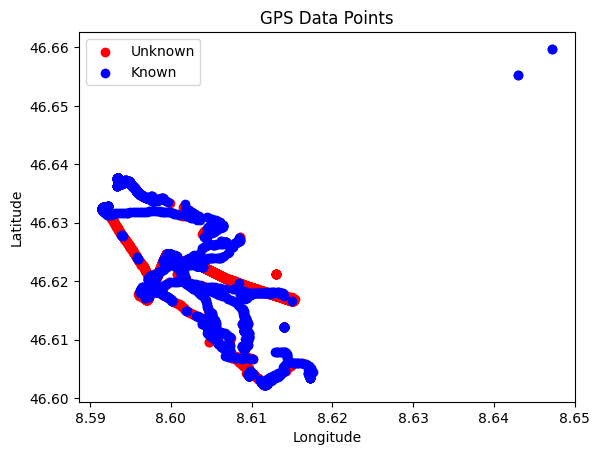

In [58]:
import matplotlib.pyplot as plt

# Plot data points with Unknown activity type
unknown_data = df_166[df_166['ActivityType'] == 'Unknown']
plt.scatter(unknown_data['Long'], unknown_data['Lat'], c='red', label='Unknown')

# Plot data points with other activity types
known_data = df_135[df_135['ActivityType'] != 'Unknown']
plt.scatter(known_data['Long'], known_data['Lat'], c='blue', label='Known')

plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('GPS Data Points')
plt.legend()
plt.show()

In [62]:
import folium
from folium import plugins

# Create a map centered on the mean latitude and longitude
map_center = [df_166['Lat'].mean(), df_166['Long'].mean()]
mymap = folium.Map(location=map_center, zoom_start=10)

# Plot data points with Unknown activity type
unknown_data = df_166[df_166['on_lift'] == 1]
for _, row in unknown_data.iterrows():
    folium.CircleMarker(location=[row['Lat'], row['Long']], radius=5, color='red', fill=True, fill_color='red').add_to(mymap)

# Plot data points with other activity types
known_data = df_135[df_135['on_lift'] != 1]
for _, row in known_data.iterrows():
    folium.CircleMarker(location=[row['Lat'], row['Long']], radius=5, color='blue', fill=True, fill_color='blue').add_to(mymap)

# Display the map in the notebook
mymap

In [42]:
import gmplot

# Initialize the Google Maps plot centered at the mean latitude and longitude
gmap = gmplot.GoogleMapPlotter(df_135['Lat'].mean(), df_135['Long'].mean(), 10)

# Plot data points with Unknown activity type
unknown_data = df_135[df_135['ActivityType'] == 'Unknown']
gmap.scatter(unknown_data['Lat'], unknown_data['Long'], 'red', size=40, marker=False)

# Plot data points with other activity types
known_data = df_135[df_135['ActivityType'] != 'Unknown']
gmap.scatter(known_data['Lat'], known_data['Long'], 'blue', size=40, marker=False)

# Draw the map to an HTML file
gmap.draw("map.html")

In [44]:
gmap

In [27]:
import webbrowser

# Specify the path to the HTML file
html_file_path = "map.html"

# Open the HTML file in the default web browser
webbrowser.open(html_file_path)

False

In [28]:


import webbrowser

# Specify the path to the HTML file
html_file_path = "map.html"

# Open the HTML file in the default web browser
success = webbrowser.open(html_file_path)

if success:
    print("Web browser opened successfully.")
else:
    print("Failed to open web browser.")

Failed to open web browser.


In [29]:
from IPython.display import IFrame

# Specify the path to the HTML file generated by Folium
html_file_path = "map.html"

# Display the HTML file in the notebook
IFrame(src=html_file_path, width=700, height=600)

In [30]:
# Convert 'ActivityConfidence' column to float, ignoring errors
#df_135['ActivityConfidence'] = pd.to_numeric(df_135['ActivityConfidence'], errors='coerce')

In [28]:
#df_135.info()

In [29]:
#df_135['ActivityConfidence'].value_counts

In [ ]:
# Convert 'ActivityConfidence' column to float, replacing NaN with 0
#df_135['ActivityConfidence'] = pd.to_numeric(df_135['ActivityConfidence'], errors='coerce').fillna(0)

In [ ]:
df_135['ActivityConfidence'].value_counts

<bound method IndexOpsMixin.value_counts of 0       0.0
1       0.0
2       0.0
3       0.0
4       0.0
       ... 
8108    0.0
8109    0.0
8110    0.0
8111    0.0
8112    0.0
Name: ActivityConfidence, Length: 8113, dtype: float64>

In [ ]:
#df_135 = df_135.drop(columns=['ActivityConfidence'])

In [47]:
from sklearn.ensemble import RandomForestClassifier

clf = RandomForestClassifier()

In [49]:
clf.fit(X_train, y_train)

ValueError: could not convert string to float: 'High'

In [48]:
from sklearn.preprocessing import LabelEncoder

# Instantiate LabelEncoder
label_encoder = LabelEncoder()

# Encode the target variable (ActivityType) into numerical values
y_test_encoded = label_encoder.fit_transform(y_test)

# Now, evaluate the performance of the trained model on the test set
y_pred = clf.predict(X_test_imputed)
print(classification_report(y_test_encoded, y_pred))

NotFittedError: This RandomForestClassifier instance is not fitted yet. Call 'fit' with appropriate arguments before using this estimator.

In [40]:
from sklearn.impute import SimpleImputer

# Instantiate the imputer with strategy 'mean', 'median', or 'most_frequent'
imputer = SimpleImputer(strategy='mean')

# Fit the imputer to the training data and transform the data
X_train_imputed = imputer.fit_transform(X_train_encoded)

# Now, train the RandomForestClassifier using X_train_imputed
clf.fit(X_train_imputed, y_train_encoded)

NameError: name 'y_train_encoded' is not defined

In [9]:
# Concatenate the training and test sets
concatenated_df = pd.concat([X_train, X_test], axis=0)

In [10]:
# One-hot encode categorical columns in the concatenated DataFrame
concatenated_encoded = pd.get_dummies(concatenated_df, columns=categorical_columns)

In [12]:
# Separate the training and test sets after one-hot encoding
X_train_encoded = concatenated_encoded.iloc[:len(X_train)]
X_test_encoded = concatenated_encoded.iloc[len(X_train):]

In [13]:
# Impute missing values in the test set using the same imputer fitted on the training set
X_test_imputed = imputer.transform(X_test_encoded)

In [ ]:
from sklearn.preprocessing import LabelEncoder

# Instantiate LabelEncoder
label_encoder = LabelEncoder()

# Encode the target variable (ActivityType) into numerical values
y_test_encoded = label_encoder.fit_transform(y_test)

# Now, evaluate the performance of the trained model on the test set
y_pred = clf.predict(X_test_imputed)
print(classification_report(y_test_encoded, y_pred))

In [44]:
# Now, evaluate the performance of the trained model on the test set
y_pred = clf.predict(X_test_imputed)
print(classification_report(y_test_encoded, y_pred))

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


AttributeError: 'RandomForestClassifier' object has no attribute 'n_classes_'

In [ ]:
# Concatenate the training and test sets
concatenated_df = pd.concat([X_train, X_test], axis=0)

# One-hot encode categorical columns in the concatenated DataFrame
concatenated_encoded = pd.get_dummies(concatenated_df, columns=categorical_columns)

# Separate the training and test sets after one-hot encoding
X_train_encoded = concatenated_encoded.iloc[:len(X_train)]
X_test_encoded = concatenated_encoded.iloc[len(X_train):]

# Impute missing values in the test set using the same imputer fitted on the training set
X_test_imputed = imputer.transform(X_test_encoded)

# Now, evaluate the performance of the trained model on the test set
y_pred = clf.predict(X_test_imputed)
print(classification_report(y_test_encoded, y_pred))

In [34]:
# Assuming X_train contains the features for training
# Identify categorical columns
categorical_columns = X_train.select_dtypes(include=['object']).columns

In [35]:
# Assuming X_train contains the features for training
# Identify categorical columns
categorical_columns = X_train.select_dtypes(include=['object']).columns

In [43]:

# Now, train the RandomForestClassifier using X_train_encoded
clf.fit(X_train_encoded, y_train_encoded)

NameError: name 'y_train_encoded' is not defined

In [37]:


# Assuming X_train contains the features for training
# Identify categorical columns
categorical_columns = X_train.select_dtypes(include=['object']).columns


In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split

# Prepare features and labels
X = df_135.drop(['ActivityType', 'Timestamp'], axis=1)
y = df_135['ActivityType']

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a RandomForestClassifier
clf = RandomForestClassifier()
clf.fit(X_train, y_train)

# Predict activity type for Unknown data points
unknown_data = df_135[df_135['ActivityType'] == 'Unknown']
unknown_features = unknown_data.drop(['ActivityType', 'Timestamp'], axis=1)
predicted_activity_types = clf.predict(unknown_features)

In [ ]:
unknown_data['on_lift'].value_counts()

0    2974
1    1677
Name: on_lift, dtype: int64

In [ ]:
unknown_features['on_lift'].value_counts()

0    2974
1    1677
Name: on_lift, dtype: int64

In [ ]:
df_135['on_lift'].value_counts()

0    6224
1    1889
Name: on_lift, dtype: int64

In [ ]:
predicted_activity_types

array(['Unknown', 'Unknown', 'Unknown', ..., 'Unknown', 'Unknown',
       'Unknown'], dtype=object)

In [ ]:
df_135['Timestamp'] = pd.to_datetime(df_135['Timestamp'])

In [ ]:
# Calculate speed based on consecutive data points
df_135['Speed'] = df_135['Speed(m/s)'].diff() / df_135['Timestamp'].diff().dt.total_seconds()

In [ ]:
df_135['Speed'].value_counts()

 0.0000    2151
 0.0160       5
 0.0107       5
 0.0199       4
 0.0515       4
           ... 
-0.0410       1
-0.0454       1
 0.1553       1
-0.0881       1
-2.1179       1
Name: Speed, Length: 5504, dtype: int64

In [ ]:
df_135['Speed'].sum

<bound method NDFrame._add_numeric_operations.<locals>.sum of 0          NaN
1      -0.0609
2      -0.0673
3      -0.0015
4       0.0000
         ...  
8108    0.0000
8109    0.0000
8110    0.0000
8111    0.0000
8112    0.0000
Name: Speed, Length: 8113, dtype: float64>

In [ ]:
df_135_unkown = df_135[df_135['ActivityType'] == 'Unknown']

In [ ]:
# Convert 'Timestamp' to datetime if it's not already in datetime format
df_135_unkown['Timestamp'] = pd.to_datetime(df_135_unkown['Timestamp'])

In [ ]:
# Convert 'Timestamp' to datetime if it's not already in datetime format
df_135_unkown['Timestamp'] = pd.to_datetime(df_135_unkown['Timestamp'])

# Sort the DataFrame by the 'Timestamp' column
df_135_unkown = df_135_unkown.sort_values(by='Timestamp')

# Calculate the speed
df_135_unkown['Speed'] = df_135_unkown['Speed(m/s)'].diff() / df_135_unkown['Timestamp'].diff().dt.total_seconds()

# Display the DataFrame
print(df_135_unkown)

               Timestamp  accelX(g)  accelY(g)  accelZ(g)  accelUserX(g)  \
0    2024-02-03 09:14:05     0.0779    -0.7570    -0.6574         0.0067   
1    2024-02-03 09:14:06    -0.0195    -0.6400    -0.7388        -0.0120   
3    2024-02-03 09:14:08     0.1354    -0.8035    -0.5651         0.0218   
4    2024-02-03 09:14:09     0.0150    -0.6509    -0.7989        -0.0084   
5    2024-02-03 09:14:10    -0.0412    -0.6396    -0.7664        -0.0215   
...                  ...        ...        ...        ...            ...   
8081 2024-02-03 11:28:46    -0.3297    -0.9833     0.1008        -0.0548   
8082 2024-02-03 11:28:47    -0.3636    -1.2106     0.0607        -0.0560   
8083 2024-02-03 11:28:48    -0.1037    -0.9989     0.3052         0.1376   
8084 2024-02-03 11:28:49    -0.3166    -0.8923     0.0927         0.0062   
8085 2024-02-03 11:28:50    -0.3053    -0.8790     0.0891        -0.0542   

      accelUserY(g)  accelUserZ(g)  gyroX(rad/s)  gyroY(rad/s)  gyroZ(rad/s)  \
0      

In [ ]:
df_135_unkown['Speed'].value_counts()

 0.000000    762
 0.010700      5
-0.036500      3
 0.021100      3
-0.024700      3
            ... 
 1.327900      1
 1.715400      1
-1.264100      1
-1.686100      1
-0.022126      1
Name: Speed, Length: 3645, dtype: int64

In [ ]:
df_135_unkown['Speed']

0          NaN
1      -0.0609
3      -0.0344
4       0.0000
5      -0.0116
         ...  
8081    0.0000
8082    0.0000
8083    0.0000
8084    0.0000
8085    0.0000
Name: Speed, Length: 4651, dtype: float64

In [ ]:
file_166='/content/df_166m.csv'
df_166=pd.read_csv(file_166)

In [ ]:
file_206='/content/df_206_labeled_on_lift.csv'
df_206=pd.read_csv(file_206)

In [ ]:
file_290='/content/df_290_labeled_on_lift.csv'
df_290=pd.read_csv(file_290)

In [ ]:
file_310='/content/df_310_labeled_on_lift.csv'
df_310=pd.read_csv(file_310)

In [ ]:
file_57='/content/df_57_labeled_on_lift.csv'
df_57=pd.read_csv(file_57)

In [ ]:
file_95='/content/df_95_labeled_on_lift.csv'
df_95=pd.read_csv(file_95)

In [ ]:
df_166

,Timestamp,accelX(g),accelY(g),accelZ(g),accelUserX(g),accelUserY(g),accelUserZ(g),gyroX(rad/s),gyroY(rad/s),gyroZ(rad/s),...,ActivityConfidence,Pressure(kilopascals),RelativeAltitude(meters),magX(µT),magY(µT),magZ(µT),calMagX(µT),calMagY(µT),calMagZ(µT),on_lift
0,2024-02-04 09:45:35,0.1922,-0.3479,-0.9826,0.0070,0.1008,0.0347,-0.2991,0.1544,-0.0899,...,High,76.1190,0.0000,453.5881,-134.0068,-256.9979,-9.0679,-27.6036,-45.7127,1
1,2024-02-04 09:45:36,0.0908,-0.3970,-0.6866,-0.0714,0.0364,0.2205,0.2636,-0.0981,0.1425,...,High,76.1190,0.0000,454.2118,-134.6189,-255.8427,-8.6285,-27.0907,-45.4847,1
2,2024-02-04 09:45:37,0.0375,-0.3651,-0.9360,-0.0546,0.0005,-0.0351,0.3272,-0.2148,0.1573,...,High,76.1097,0.9802,440.7044,-129.3311,-257.2758,-22.6558,-22.7829,-46.3289,1
3,2024-02-04 09:45:38,0.0144,-0.2673,-0.8922,-0.0412,-0.0190,0.0732,0.0626,0.0634,0.2389,...,High,76.1004,1.9604,439.4838,-126.7298,-256.5003,-23.4059,-19.9219,-45.7558,1
4,2024-02-04 09:45:39,0.1912,-0.4596,-0.8941,0.0340,-0.0016,-0.0177,-0.3062,-0.1541,-0.4590,...,High,76.0811,3.9846,447.4849,-140.8846,-252.6759,-15.0221,-33.9742,-42.2803,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9972,2024-02-04 12:31:47,0.1110,-0.3860,-0.9501,0.0225,0.0001,-0.0318,-0.0175,-0.0658,-0.0575,...,High,86.6771,-1050.4675,476.1945,-98.4749,-258.0012,15.0356,17.2029,-53.0718,0
9973,2024-02-04 12:31:48,0.1183,-0.4548,-0.8775,-0.0029,0.0028,0.0034,0.3672,0.1847,-0.1411,...,High,86.6766,-1050.4172,474.7724,-101.2614,-259.6018,14.1055,13.7433,-54.8372,0
9974,2024-02-04 12:31:49,0.0307,-0.3138,-1.0033,-0.0263,0.0560,-0.0760,-0.2479,0.0765,0.2282,...,High,86.6760,-1050.3618,474.2478,-97.8393,-258.5081,13.4764,17.7510,-53.3673,0
9975,2024-02-04 12:31:50,0.2079,-0.5283,-0.7354,-0.0256,0.0259,0.0455,0.8074,0.6234,-0.2329,...,High,86.6754,-1050.3037,479.4745,-106.3946,-258.5123,18.9932,8.1825,-53.8499,0


In [ ]:
df_166.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9977 entries, 0 to 9976
Data columns (total 45 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Timestamp                 9977 non-null   object 
 1   accelX(g)                 9977 non-null   float64
 2   accelY(g)                 9977 non-null   float64
 3   accelZ(g)                 9977 non-null   float64
 4   accelUserX(g)             9977 non-null   float64
 5   accelUserY(g)             9977 non-null   float64
 6   accelUserZ(g)             9977 non-null   float64
 7   gyroX(rad/s)              9977 non-null   float64
 8   gyroY(rad/s)              9977 non-null   float64
 9   gyroZ(rad/s)              9977 non-null   float64
 10  Roll(rads)                9977 non-null   float64
 11  Pitch(rads)               9977 non-null   float64
 12  Yaw(rads)                 9977 non-null   float64
 13  m11                       9977 non-null   float64
 14  m12     

In [ ]:
df_166.columns

Index(['Timestamp', 'accelX(g)', 'accelY(g)', 'accelZ(g)', 'accelUserX(g)',
       'accelUserY(g)', 'accelUserZ(g)', 'gyroX(rad/s)', 'gyroY(rad/s)',
       'gyroZ(rad/s)', 'Roll(rads)', 'Pitch(rads)', 'Yaw(rads)', 'm11', 'm12',
       'm13', 'm21', 'm22', 'm23', 'm31', 'm32', 'm33', 'qX', 'qY', 'qZ', 'qW',
       'Lat', 'Long', 'Speed(m/s)', 'TrueHeading', 'Alt(m)',
       'HorizontalAccuracy(m)', 'VerticalAccuracy(m)', 'Course',
       'ActivityType', 'ActivityConfidence', 'Pressure(kilopascals)',
       'RelativeAltitude(meters)', 'magX(µT)', 'magY(µT)', 'magZ(µT)',
       'calMagX(µT)', 'calMagY(µT)', 'calMagZ(µT)', 'on_lift'],
      dtype='object')

In [ ]:
import geopandas as gpd
from shapely.geometry import Point

# Coordinate system
crs = {'init': 'epsg:4326'}

# Create GPS points
geometry = [Point(xy) for xy in zip(df_166['Long'], df_166['Lat'])]

# Create a GeoDataFrame with GPS data points
geo_df = gpd.GeoDataFrame(df_166, crs=crs, geometry=geometry)

# Reduce data to every 60 seconds
reduced_df = df_166.iloc[::60, :].copy()

# Update the geometry column in the reduced DataFrame
reduced_df['geometry'] = [Point(xy) for xy in zip(reduced_df['Long'], reduced_df['Lat'])]
reduced_geo_df = gpd.GeoDataFrame(reduced_df, crs=crs, geometry='geometry')

reduced_df.head(5)

/usr/local/lib/python3.10/dist-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
/usr/local/lib/python3.10/dist-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


,Timestamp,accelX(g),accelY(g),accelZ(g),accelUserX(g),accelUserY(g),accelUserZ(g),gyroX(rad/s),gyroY(rad/s),gyroZ(rad/s),...,Pressure(kilopascals),RelativeAltitude(meters),magX(µT),magY(µT),magZ(µT),calMagX(µT),calMagY(µT),calMagZ(µT),on_lift,geometry
0,2024-02-04 09:45:35,0.1922,-0.3479,-0.9826,0.0070,0.1008,0.0347,-0.2991,0.1544,-0.0899,...,76.1190,0.0000,453.5881,-134.0068,-256.9979,-9.0679,-27.6036,-45.7127,1,POINT (8.61302 46.621187)
60,2024-02-04 09:46:35,-0.2087,-1.0046,-0.0341,-0.0218,0.0033,-0.0643,0.0072,-0.0052,-0.0186,...,74.7895,140.5212,522.2668,-166.1624,-238.9537,59.0228,-59.0778,-28.5703,1,POINT (8.607195 46.60784)
120,2024-02-04 09:47:35,-0.1760,-0.9309,0.1793,0.0340,0.0037,-0.0177,-0.0027,-0.0061,0.0122,...,72.6083,375.4922,450.1199,-170.3495,-202.9528,-12.8768,-63.3589,7.8587,1,POINT (8.609496 46.604096)
180,2024-02-04 09:48:35,-0.2133,-0.9565,0.1923,0.0066,-0.0028,-0.0114,0.0010,0.0110,0.0103,...,71.7937,464.7100,444.2596,-174.0866,-198.9357,-18.6951,-67.1057,11.7804,1,POINT (8.609711 46.603722)
240,2024-02-04 09:49:35,-0.0155,-0.9238,0.2107,0.0850,0.0210,-0.0202,0.2519,0.1800,-0.2943,...,71.7873,465.4075,449.2575,-142.2467,-186.1062,-13.8119,-35.1551,24.5745,1,POINT (8.614006 46.612081)


In [ ]:
import geopandas as gpd
from shapely.geometry import Point

# Coordinate system
crs = {'init': 'epsg:4326'}

# Function to create GeoDataFrame and reduce data
def create_and_reduce(df):
    # Create GPS points
    geometry = [Point(xy) for xy in zip(df['Long'], df['Lat'])]

    # Create a GeoDataFrame with GPS data points
    geo_df = gpd.GeoDataFrame(df, crs=crs, geometry=geometry)

    # Reduce data to every 60 seconds
    reduced_df = df.iloc[::60, :].copy()

    # Update the geometry column in the reduced DataFrame
    reduced_df['geometry'] = [Point(xy) for xy in zip(reduced_df['Long'], reduced_df['Lat'])]
    reduced_geo_df = gpd.GeoDataFrame(reduced_df, crs=crs, geometry='geometry')

    return reduced_df

# Create and reduce GeoDataFrames for each DataFrame
reduced_df_135 = create_and_reduce(df_135)
reduced_df_206 = create_and_reduce(df_206)
reduced_df_290 = create_and_reduce(df_290)
reduced_df_310 = create_and_reduce(df_310)
reduced_df_57 = create_and_reduce(df_57)
reduced_df_95 = create_and_reduce(df_95)

/usr/local/lib/python3.10/dist-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
/usr/local/lib/python3.10/dist-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
/usr/local/lib/python3.10/dist-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of 

In [ ]:
import folium

# Create a Folium map centered at the first point of the reduced DataFrame
m = folium.Map(location=[reduced_df['Lat'].iloc[0], reduced_df['Long'].iloc[0]], zoom_start=15)

# Add markers for each data point in the reduced DataFrame
for index, row in reduced_df.iterrows():
    folium.Marker([row['Lat'], row['Long']], popup=f"Timestamp: {row['Timestamp']}").add_to(m)

# Display the map
m

In [ ]:
import folium

# Function to create Folium map for reduced DataFrame
def create_folium_map(reduced_df):
    # Create a Folium map centered at the first point of the reduced DataFrame
    m = folium.Map(location=[reduced_df['Lat'].iloc[0], reduced_df['Long'].iloc[0]], zoom_start=15)

    # Add markers for each data point in the reduced DataFrame
    for index, row in reduced_df.iterrows():
        folium.Marker([row['Lat'], row['Long']], popup=f"Timestamp: {row['Timestamp']}").add_to(m)

    # Display the map
    return m

# Create Folium maps for all reduced DataFrames
folium_maps = {}
for key, reduced_df in {'df_135': reduced_df_135, 'df_206': reduced_df_206, 'df_290': reduced_df_290, 'df_310': reduced_df_310, 'df_57': reduced_df_57, 'df_95': reduced_df_95}.items():
    folium_maps[key] = create_folium_map(reduced_df)

# Display the maps
for key, folium_map in folium_maps.items():
    print(f"Map for {key}:")
    display(folium_map)

Map for df_135:


Map for df_206:


Map for df_290:


Map for df_310:


Map for df_57:


Map for df_95:


In [ ]:
import folium

# Create a Folium map centered at the first point of the reduced DataFrame
m = folium.Map(location=[reduced_df.Lat.iloc[0], reduced_df.Long.iloc[0]], zoom_start=15)

# Add a line to the map
folium.PolyLine(
    list(zip(reduced_df.Lat, reduced_df.Long)),
    color="blue",
    weight=2.5,
    opacity=1
).add_to(m)

# Display the map
m

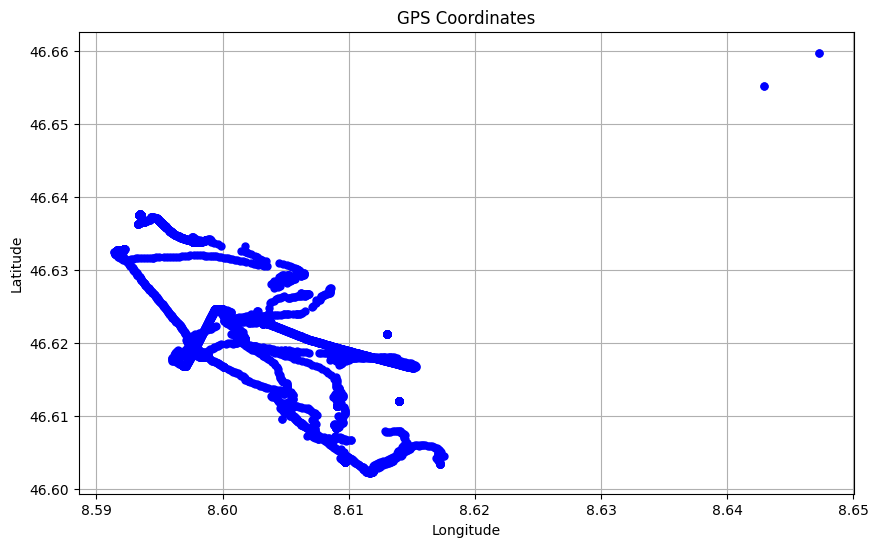

In [ ]:
import matplotlib.pyplot as plt

# Plot GPS coordinates
plt.figure(figsize=(10, 6))
plt.plot(df_166['Long'], df_166['Lat'], marker='o', linestyle='', markersize=5, color='blue')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('GPS Coordinates')
plt.grid(True)
plt.show()

In [ ]:
import plotly.graph_objects as go

# Create a scatter plot of GPS coordinates
fig = go.Figure(go.Scattermapbox(
    mode="markers",
    lon=df_166['Long'],
    lat=df_166['Lat'],
    marker=go.scattermapbox.Marker(
        size=9,
        color='blue',
        opacity=0.7
    ),
    text=df_166['Timestamp'],  # Use Timestamp as hover text
))

# Set layout parameters for the map
fig.update_layout(
    mapbox=dict(
        accesstoken=YOUR_MAPBOX_ACCESS_TOKEN,  # Replace with your Mapbox access token ,you need an account
        center=dict(
            lon=df_166['Long'].iloc[0],  # Center the map at the first point
            lat=df_166['Lat'].iloc[0]
        ),
        zoom=15
    ),
)

# Show the map
fig.show()

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.8/11.8 MB 47.1 MB/s eta 0:00:00


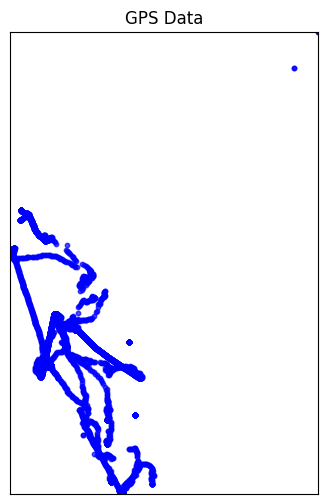

In [ ]:
import matplotlib.pyplot as plt
from mpl_toolkits.basemap import Basemap

# Create a Basemap instance
plt.figure(figsize=(10, 6))
m = Basemap(projection='merc', llcrnrlat=df_166['Lat'].min(), urcrnrlat=df_166['Lat'].max(),
            llcrnrlon=df_166['Long'].min(), urcrnrlon=df_166['Long'].max(), resolution='i')

# Plot GPS data
m.scatter(df_166['Long'], df_166['Lat'], latlon=True, s=10, c='blue', marker='o', alpha=0.7)

# Draw coastlines, countries, and states
m.drawcoastlines()
m.drawcountries()
m.drawstates()

# Add a title
plt.title('GPS Data')

# Show the plot
plt.show()

In [ ]:
pip install keplergl

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.7/9.7 MB 24.5 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Using cached jedi-0.19.1-py2.py3-none-any.whl (1.6 MB)
  Created wheel for keplergl: filename=keplergl-0.3.2-py2.py3-none-any.whl size=17922315 sha256=ffb51f102cb69d9d0627e87a97f879e6f33d5c038ce76e1a4b860c44e63c23ad
  Stored in directory: /root/.cache/pip/wheels/e5/e9/db/b8b8f2fcb5cb1cd7268d88959fce267bc00697cb8f50dcd0d9
Successfully built keplergl


In [ ]:
from keplergl import KeplerGl
import pandas as pd

# Create a Kepler.gl map
map_166 = KeplerGl(height=600)
map_166.add_data(data=pd.DataFrame(df_166), name='GPS Data')

# Display the map
map_166

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


KeplerGl(data={'GPS Data': {'index': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20…

In [ ]:
import folium

# Create a Folium map centered at the first point of the reduced DataFrame
m = folium.Map(location=[reduced_df['Lat'].iloc[0], reduced_df['Long'].iloc[0]], zoom_start=15)

# Add markers for each data point in the reduced DataFrame
for index, row in reduced_df.iterrows():
    folium.Marker([row['Lat'], row['Long']], popup=f"Timestamp: {row['Timestamp']}").add_to(m)

# Save the map to an HTML file
m.save("map.html")

In [ ]:
import gmplot

# Create a Google Maps plot centered at the first point of the reduced DataFrame
gmap = gmplot.GoogleMapPlotter(reduced_df['Lat'].iloc[0], reduced_df['Long'].iloc[0], 15)

# Plot the coordinates on the map
gmap.scatter(reduced_df['Lat'], reduced_df['Long'], '#FF0000', size=40, marker=False)

# Draw the map to an HTML file
gmap.draw("map.html")

gmap

In [ ]:
from IPython.display import IFrame

IFrame(src='map.html', width=700, height=600)